## 1. Визуализация графика обучения

In [1]:
import os
import numpy as np

Загрузим лоссы на трейне и валидации за все время обучения

In [2]:
epoch_ends = []
val_mses = np.loadtxt('val_scores_metric0.txt')
n_epochs = len(val_mses)
cur_pos = 0
for epoch in range(1, n_epochs):
    epoch_mse = np.loadtxt('scores_on_epoch{}_metric0.txt'.format(epoch + 1))
    if epoch == 1:
        train_mses = epoch_mse
    else:
        train_mses = np.concatenate([train_mses, epoch_mse])
    cur_pos += len(epoch_mse)
    epoch_ends.append(cur_pos)

In [4]:
len(val_mses)

18

In [5]:
import matplotlib.pyplot as plt
%matplotlib inline

In [6]:
def running_mean(x, n):
    cumsum = np.cumsum(x)
    return (cumsum[n:] - cumsum[:-n]) / n

In [7]:
epoch_ends = [1303] + epoch_ends

Text(0, 0.5, 'MSE')

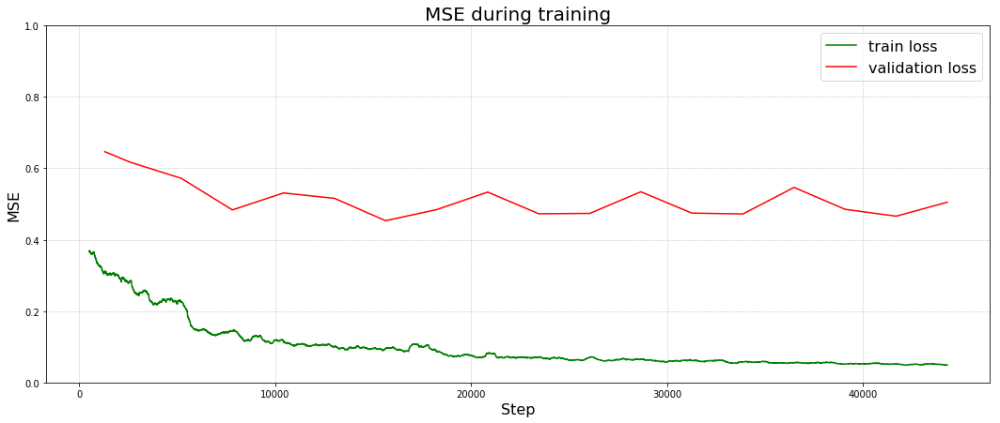

In [9]:
ylim = 1
plt.figure(figsize=(18, 7))
plt.title('MSE during training', fontsize=20)
plt.grid(ls=':')
plt.plot(np.arange(500, len(train_mses)), running_mean(train_mses, 500), color='g', label='train loss')
plt.plot(epoch_ends, val_mses, color='r', label='validation loss')
plt.ylim((0, ylim))
plt.legend(fontsize=16)
plt.xlabel('Step', fontsize=16)
plt.ylabel('MSE', fontsize=16)

In [12]:
epoch_ends = []
val_losses = np.loadtxt('val_losses.txt')
n_epochs = len(val_losses)
cur_pos = 0
for epoch in range(n_epochs):
    epoch_loss = np.loadtxt('losses_on_epoch{}.txt'.format(epoch + 1))
    if epoch == 1:
        train_losses = epoch_loss
    else:
        train_losses = np.concatenate([train_losses, epoch_loss])
    cur_pos += len(epoch_loss)
    epoch_ends.append(cur_pos)

Text(0, 0.5, 'Loss')

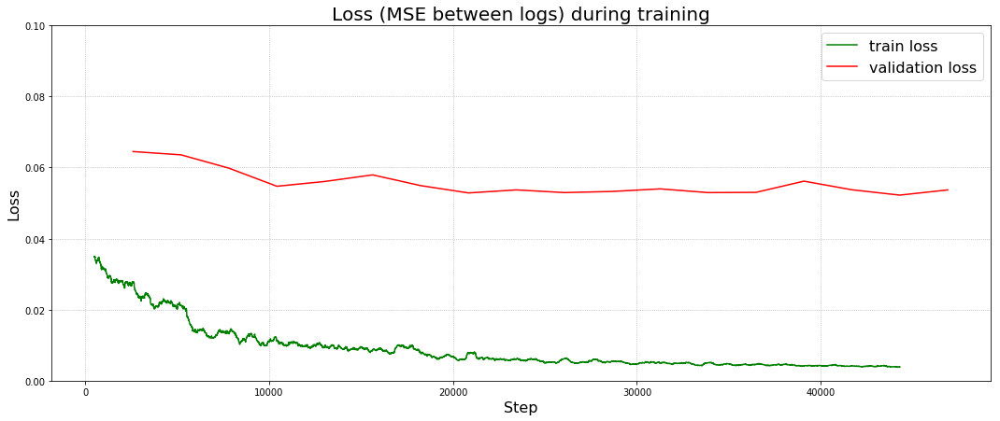

In [14]:
ylim = 0.1
plt.figure(figsize=(18, 7))
plt.title('Loss (MSE between logs) during training', fontsize=20)
plt.grid(ls=':')
plt.plot(np.arange(500, len(train_losses)), running_mean(train_losses, 500), color='g', label='train loss')
plt.plot(epoch_ends, val_losses, color='r', label='validation loss')
plt.ylim((0, ylim))
plt.legend(fontsize=16)
plt.xlabel('Step', fontsize=16)
plt.ylabel('Loss', fontsize=16)

## Визуализация работы нейросети

In [15]:
from keras.layers import Layer
from keras.engine import Layer, InputSpec
from keras import initializers
from keras import regularizers
from keras import constraints
from keras import backend as K
from keras.legacy import interfaces

class MyBatchNormalizationInference(Layer):
    """Batch normalization layer (Ioffe and Szegedy, 2014).
    Normalize the activations of the previous layer at each batch,
    i.e. applies a transformation that maintains the mean activation
    close to 0 and the activation standard deviation close to 1.
    # Arguments
        axis: Integer, the axis that should be normalized
            (typically the features axis).
            For instance, after a `Conv2D` layer with
            `data_format="channels_first"`,
            set `axis=1` in `BatchNormalization`.
        momentum: Momentum for the moving mean and the moving variance.
        epsilon: Small float added to variance to avoid dividing by zero.
        center: If True, add offset of `beta` to normalized tensor.
            If False, `beta` is ignored.
        scale: If True, multiply by `gamma`.
            If False, `gamma` is not used.
            When the next layer is linear (also e.g. `nn.relu`),
            this can be disabled since the scaling
            will be done by the next layer.
        beta_initializer: Initializer for the beta weight.
        gamma_initializer: Initializer for the gamma weight.
        moving_mean_initializer: Initializer for the moving mean.
        moving_variance_initializer: Initializer for the moving variance.
        beta_regularizer: Optional regularizer for the beta weight.
        gamma_regularizer: Optional regularizer for the gamma weight.
        beta_constraint: Optional constraint for the beta weight.
        gamma_constraint: Optional constraint for the gamma weight.
    # Input shape
        Arbitrary. Use the keyword argument `input_shape`
        (tuple of integers, does not include the samples axis)
        when using this layer as the first layer in a model.
    # Output shape
        Same shape as input.
    # References
        - [Batch Normalization: Accelerating Deep Network Training by Reducing Internal Covariate Shift](https://arxiv.org/abs/1502.03167)
    """

    @interfaces.legacy_batchnorm_support
    def __init__(self,
                 axis=-1,
                 momentum=0.99,
                 epsilon=1e-3,
                 center=True,
                 scale=True,
                 beta_initializer='zeros',
                 gamma_initializer='ones',
                 moving_mean_initializer='zeros',
                 moving_variance_initializer='ones',
                 beta_regularizer=None,
                 gamma_regularizer=None,
                 beta_constraint=None,
                 gamma_constraint=None,
                 **kwargs):
        self._trainable = True
        self._trainable_tensor = K.variable(1, dtype='float32', name='trainable')
        super(MyBatchNormalizationInference, self).__init__(**kwargs)
        self.supports_masking = True
        self.axis = axis
        self.momentum = momentum
        self.epsilon = epsilon
        self.center = center
        self.scale = scale
        self.beta_initializer = initializers.get(beta_initializer)
        self.gamma_initializer = initializers.get(gamma_initializer)
        self.moving_mean_initializer = initializers.get(moving_mean_initializer)
        self.moving_variance_initializer = initializers.get(moving_variance_initializer)
        self.beta_regularizer = regularizers.get(beta_regularizer)
        self.gamma_regularizer = regularizers.get(gamma_regularizer)
        self.beta_constraint = constraints.get(beta_constraint)
        self.gamma_constraint = constraints.get(gamma_constraint)

    @property
    def trainable(self):
        # Use cached value to avoid unnecessary get_value() calls
        return self._trainable

    @trainable.setter
    def trainable(self, trainable):
        trainable = bool(trainable)
        # Change when different to avoid unnecessary set_value() calls
        if self._trainable != trainable:
            self._trainable = trainable
            K.set_value(self._trainable_tensor, 1 if trainable else 0)

    def build(self, input_shape):
        dim = input_shape[self.axis]
        if dim is None:
            raise ValueError('Axis ' + str(self.axis) + ' of '
                             'input tensor should have a defined dimension '
                             'but the layer received an input with shape ' +
                             str(input_shape) + '.')
        self.input_spec = InputSpec(ndim=len(input_shape),
                                    axes={self.axis: dim})
        shape = (dim,)

        if self.scale:
            self.gamma = self.add_weight(shape=shape,
                                         name='gamma',
                                         initializer=self.gamma_initializer,
                                         regularizer=self.gamma_regularizer,
                                         constraint=self.gamma_constraint)
        else:
            self.gamma = None
        if self.center:
            self.beta = self.add_weight(shape=shape,
                                        name='beta',
                                        initializer=self.beta_initializer,
                                        regularizer=self.beta_regularizer,
                                        constraint=self.beta_constraint)
        else:
            self.beta = None
        self.moving_mean = self.add_weight(
            shape=shape,
            name='moving_mean',
            initializer=self.moving_mean_initializer,
            trainable=False)
        self.moving_variance = self.add_weight(
            shape=shape,
            name='moving_variance',
            initializer=self.moving_variance_initializer,
            trainable=False)
        self.built = True

    def call(self, inputs, training=None):
        input_shape = K.int_shape(inputs)
        # Prepare broadcasting shape.
        ndim = len(input_shape)
        reduction_axes = list(range(len(input_shape)))
        del reduction_axes[self.axis]
        broadcast_shape = [1] * len(input_shape)
        broadcast_shape[self.axis] = input_shape[self.axis]

        # Determines whether broadcasting is needed.
        needs_broadcasting = (sorted(reduction_axes) != list(range(ndim))[:-1])

        def normalize_inference():
            if needs_broadcasting:
                # In this case we must explicitly broadcast all parameters.
                broadcast_moving_mean = K.reshape(self.moving_mean,
                                                  broadcast_shape)
                broadcast_moving_variance = K.reshape(self.moving_variance,
                                                      broadcast_shape)
                if self.center:
                    broadcast_beta = K.reshape(self.beta, broadcast_shape)
                else:
                    broadcast_beta = None
                if self.scale:
                    broadcast_gamma = K.reshape(self.gamma,
                                                broadcast_shape)
                else:
                    broadcast_gamma = None
                return K.batch_normalization(
                    inputs,
                    broadcast_moving_mean,
                    broadcast_moving_variance,
                    broadcast_beta,
                    broadcast_gamma,
                    epsilon=self.epsilon)
            else:
                return K.batch_normalization(
                    inputs,
                    self.moving_mean,
                    self.moving_variance,
                    self.beta,
                    self.gamma,
                    epsilon=self.epsilon)

        return normalize_inference()

    def get_config(self):
        config = {
            'axis': self.axis,
            'momentum': self.momentum,
            'epsilon': self.epsilon,
            'center': self.center,
            'scale': self.scale,
            'beta_initializer': initializers.serialize(self.beta_initializer),
            'gamma_initializer': initializers.serialize(self.gamma_initializer),
            'moving_mean_initializer': initializers.serialize(self.moving_mean_initializer),
            'moving_variance_initializer': initializers.serialize(self.moving_variance_initializer),
            'beta_regularizer': regularizers.serialize(self.beta_regularizer),
            'gamma_regularizer': regularizers.serialize(self.gamma_regularizer),
            'beta_constraint': constraints.serialize(self.beta_constraint),
            'gamma_constraint': constraints.serialize(self.gamma_constraint)
        }
        base_config = super(MyBatchNormalizationInference, self).get_config()
        return dict(list(base_config.items()) + list(config.items()))

    def compute_output_shape(self, input_shape):
        return input_shape

Using TensorFlow backend.


In [16]:
import sys
sys.path.append('/home/kmouraviev')

In [17]:
from tensorflow_resnet.my_batch_normalization import MyBatchNormalization

In [18]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [19]:
import h5py
train_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/train_data_fullsize_small.hdf5', 'r')
rgbs_train = train_data_file['data']
depths_train = train_data_file['label']
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes.hdf5', 'r')
rgbs_val = val_data_file['data']
depths_val = val_data_file['label']
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = test_data_file['data']
depths_test = test_data_file['label']

In [20]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [21]:
import tensorflow as tf

In [22]:
def berhu_loss(labels, predictions, delta=1.0):
    error = tf.abs(labels - predictions)
    loss = tf.where(error < delta,
                    error,
                    (error ** 2 + delta ** 2) / (2 * delta)
                   )
    return tf.reduce_mean(loss)

In [23]:
def mse_between_logarithms(labels, predictions):
    log_labels = tf.log(labels + 1)
    log_predictions = tf.log(predictions + 1)
    return (log_labels - log_predictions) ** 2

In [24]:
def relative_error(labels, predictions):
    return tf.reduce_mean((labels - predictions) ** 2 / (predictions + 0.1))

In [28]:
%%time
from keras.models import load_model
model = load_model('model_on_epoch17.hdf5', 
                   custom_objects={'MyBatchNormalization': MyBatchNormalizationInference,
                                   'mse_between_logarithms': mse_between_logarithms
                                  }
                  )

CPU times: user 32 s, sys: 1.43 s, total: 33.5 s
Wall time: 32 s


### Обучающая выборка

In [29]:
rgbs_train_sample = np.array(rgbs_train[::1000])
depths_train_sample = np.array(depths_train[::1000])

In [30]:
train_prediction = model.predict(rgbs_train_sample, batch_size=32)

In [31]:
sq_diff = (train_prediction - depths_train_sample) ** 2

In [32]:
print('train MSE:', np.mean((train_prediction - depths_train_sample) ** 2))

train MSE: 0.04283408577691848


In [33]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

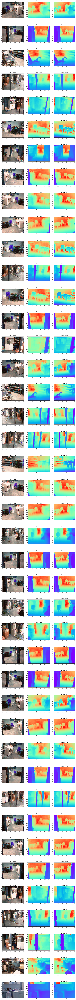

In [34]:
n = len(rgbs_train_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_train_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_train_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(train_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_train_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: те же коллекции, другие сцены

In [35]:
rgbs_val_sample = np.array(rgbs_val)
depths_val_sample = np.array(depths_val)

In [36]:
%%time
val_prediction = model.predict(rgbs_val_sample, batch_size=32)

CPU times: user 1min 31s, sys: 3min 15s, total: 4min 46s
Wall time: 4min 21s


In [37]:
sq_diff = (val_prediction - depths_val_sample) ** 2

In [38]:
sq_diff.shape

(14266, 384, 512)

Изучим ошибку на объектах разной дальности

In [39]:
print('MSE when depth < 1m:',
      sq_diff[depths_val_sample < 1].sum() / (depths_val_sample < 1).sum())
target_depths = np.logical_and(depths_val_sample > 1, depths_val_sample < 2)
print('MSE when depth is between 1m and 2m:', \
      sq_diff[target_depths].sum() / target_depths.sum())
target_depths = np.logical_and(depths_val_sample > 2, depths_val_sample < 5)
print('MSE when depth is between 2m and 5m:', \
      sq_diff[target_depths].sum() / target_depths.sum())
target_depths = (depths_val_sample > 5)
print('MSE when depth > 5m:', \
      sq_diff[target_depths].sum() / target_depths.sum())

MSE when depth < 1m: 0.465632028654905
MSE when depth is between 1m and 2m: 0.19446666289084963
MSE when depth is between 2m and 5m: 0.30894749954022316
MSE when depth > 5m: 2.125725385064984


In [40]:
print('Validation depth sample contains:')
print('Depths < 1m: {}%'.format(np.round((depths_val_sample < 1).mean() * 100, 1)))
target_depths = np.logical_and(depths_val_sample > 1, depths_val_sample < 2)
print('Depths between 1m and 2m: {}%'.format(np.round(target_depths.mean() * 100, 1)))
target_depths = np.logical_and(depths_val_sample > 2, depths_val_sample < 5)
print('Depths between 2m and 5m: {}%'.format(np.round(target_depths.mean() * 100, 1)))
print('Depths > 5m: {}%'.format(np.round((depths_val_sample > 5).mean() * 100, 1)))

Validation depth sample contains:
Depths < 1m: 4.1%
Depths between 1m and 2m: 36.6%
Depths between 2m and 5m: 48.7%
Depths > 5m: 10.6%


In [41]:
print('validation MSE:', np.mean((val_prediction - depths_val_sample) ** 2))

validation MSE: 0.4659510149228544


In [42]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

In [43]:
rgbs_val_sample = rgbs_val_sample[::534]
depths_val_sample = depths_val_sample[::534]
val_prediction_sample = val_prediction[::534]

In [44]:
val_prediction_sample = np.clip(val_prediction_sample, 0.5, 10)

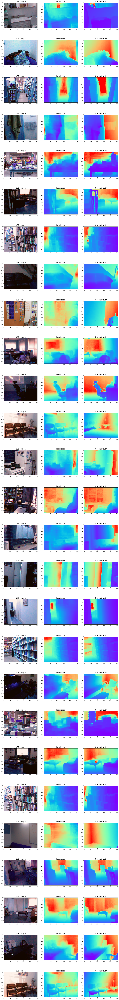

In [45]:
n = len(rgbs_val_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_val_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(val_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

In [46]:
for i in range(len(val_prediction_sample)):
    print('Pic. {}: MSE = {}'.format(i, np.mean((val_prediction_sample[i] - depths_val_sample[i]) ** 2)))

Pic. 0: MSE = 0.39755002935557426
Pic. 1: MSE = 0.5207738251853424
Pic. 2: MSE = 1.798114258012608
Pic. 3: MSE = 0.1469797602323615
Pic. 4: MSE = 1.2630089699222575
Pic. 5: MSE = 0.41112174074272084
Pic. 6: MSE = 0.41951010301056213
Pic. 7: MSE = 0.32275443146115523
Pic. 8: MSE = 0.5243142234162729
Pic. 9: MSE = 0.36061471993456284
Pic. 10: MSE = 0.09806928429618618
Pic. 11: MSE = 0.27077005133365356
Pic. 12: MSE = 0.3317766180502864
Pic. 13: MSE = 0.15356957822952505
Pic. 14: MSE = 0.15245997397727654
Pic. 15: MSE = 0.02482232902812595
Pic. 16: MSE = 0.5886695665835878
Pic. 17: MSE = 0.44220796264482015
Pic. 18: MSE = 0.10611463172517387
Pic. 19: MSE = 2.464173556604799
Pic. 20: MSE = 0.18185213838908396
Pic. 21: MSE = 0.387105789799886
Pic. 22: MSE = 0.02496114501595421
Pic. 23: MSE = 0.3481740072212301
Pic. 24: MSE = 0.2080473216222646
Pic. 25: MSE = 0.3371731666621189
Pic. 26: MSE = 0.16667762267684894


### Валидационная выборка: другие коллекции

In [47]:
for layer in model.layers:
    if layer.name.startswith('my_batch'):
        K.set_value(layer._trainable_tensor, 0)

In [48]:
model.build(input_shape=(384, 512, 3))

In [49]:
rgbs_test_sample = np.array(rgbs_test)
depths_test_sample = np.array(depths_test)

In [50]:
model.compile(optimizer='adam', loss='mse')

In [51]:
import keras.backend as K
sess = K.get_session()

In [52]:
%%time
test_prediction = model.predict(rgbs_test_sample, batch_size=1)

CPU times: user 59.8 s, sys: 49.7 s, total: 1min 49s
Wall time: 1min 40s


In [53]:
test_prediction = np.clip(test_prediction, 0.5, 10)

In [54]:
print('second-validation MSE:', np.mean((test_prediction - depths_test_sample) ** 2))

second-validation MSE: 0.6388423160138128


In [55]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

In [56]:
rgbs_test_sample = rgbs_test_sample[::100]
depths_test_sample = depths_test_sample[::100]
test_prediction_sample = test_prediction[::100]
test_prediction_sample = np.clip(test_prediction_sample, 0.5, 10)

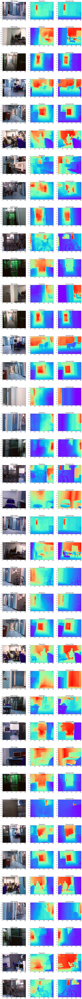

In [57]:
n = len(rgbs_test_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_test_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(test_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')

### Изучение ошибки на объектах разной дальности

In [ ]:
rgbs_test_sample = np.array(rgbs_test)
depths_test_sample = np.array(depths_test)

In [ ]:
sq_diff = (test_prediction - depths_test_sample) ** 2

In [ ]:
print('MSE when depth < 1m:',
      np.round(sq_diff[depths_test_sample < 1].sum() / (depths_test_sample < 1).sum(), 3))
target_depths = np.logical_and(depths_test_sample > 1, depths_test_sample < 2)
print('MSE when depth is between 1m and 2m:', \
      np.round(sq_diff[target_depths].sum() / target_depths.sum(), 3))
target_depths = np.logical_and(depths_test_sample > 2, depths_test_sample < 5)
print('MSE when depth is between 2m and 5m:', \
      np.round(sq_diff[target_depths].sum() / target_depths.sum(), 3))
target_depths = (depths_test_sample > 5)
print('MSE when depth > 5m:', \
      np.round(sq_diff[target_depths].sum() / target_depths.sum(), 3))

In [ ]:
print('Depths sample contains:')
print('Depths < 1m: {}%'.format(np.round((depths_test_sample < 1).mean() * 100, 1)))
target_depths = np.logical_and(depths_test_sample > 1, depths_test_sample < 2)
print('Depths between 1m and 2m: {}%'.format(np.round(target_depths.mean() * 100, 1)))
target_depths = np.logical_and(depths_test_sample > 2, depths_test_sample < 5)
print('Depths between 2m and 5m: {}%'.format(np.round(target_depths.mean() * 100, 1)))
print('Depths > 5m: {}%'.format(np.round((depths_test_sample > 5).mean() * 100, 1)))

In [ ]:
depths_test_sample[depths_test_sample < 0.5] = 0.5
test_prediction[test_prediction < 0.5] = 0.5
print('MSE between logs:', np.mean((np.log(test_prediction) - np.log(depths_test_sample)) ** 2))